<a href="https://colab.research.google.com/github/El-Do-RaDo/Music-Genration-with-RNN/blob/master/Music_genration_using_RNN_tensorflow.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Music Generation with RNNs
In this portion of the lab, we will explore building a Recurrent Neural Network (RNN) for music generation. We will train a model to learn the patterns in raw sheet music in ABC notation and then use this model to generate new music.

In [0]:
import tensorflow as tf

!pip install mitdeeplearning
import mitdeeplearning as mdl

import numpy as np
import os
import time
import functools
from IPython import display as ipythondisplay
from tqdm import tqdm
!apt-get install abcmidi timidity > /dev/null 2>&1

 # Dataset
Let's Dance!



![alt text](https://camo.githubusercontent.com/688dacac19694e9824928ffbad89178a7a6464a7/687474703a2f2f33332e6d656469612e74756d626c722e636f6d2f33643232333935346164306137376634653938613762383731333661613339352f74756d626c725f6e6c6374356c4656624631716875376f696f315f3530302e676966)


We've gathered a dataset of thousands of Irish folk songs, represented in the ABC notation. Let's download the dataset and inspect it:

In [0]:
songs = mdl.lab1.load_training_data()

example_song = songs[0]
print("\nExample song: ")
print(example_song)
print("\nThe length of dataset is {}".format(len(songs)))

Found 816 songs in text

Example song: 
X:2
T:An Buachaill Dreoite
Z: id:dc-hornpipe-2
M:C|
L:1/8
K:G Major
GF|DGGB d2GB|d2GF Gc (3AGF|DGGB d2GB|dBcA F2GF|!
DGGB d2GF|DGGF G2Ge|fgaf gbag|fdcA G2:|!
GA|B2BG c2cA|d2GF G2GA|B2BG c2cA|d2DE F2GA|!
B2BG c2cA|d^cde f2 (3def|g2gf gbag|fdcA G2:|!

The length of dataset is 816


In [0]:
mdl.lab1.play_song(example_song)

In [0]:
songs_joined = "\n\n".join(songs) 

vocab = sorted(set(songs_joined))
print("There are", len(vocab), "unique characters in the dataset")

There are 83 unique characters in the dataset


# Process the dataset for the learning task
Let's take a step back and consider our prediction task. We're trying to train a RNN model to learn patterns in ABC music, and then use this model to generate (i.e., predict) a new piece of music based on this learned information.

Breaking this down, what we're really asking the model is: given a character, or a sequence of characters, what is the most probable next character? We'll train the model to perform this task.

To achieve this, we will input a sequence of characters to the model, and train the model to predict the output, that is, the following character at each time step. RNNs maintain an internal state that depends on previously seen elements, so information about all characters seen up until a given moment will be taken into account in generating the prediction.

Vectorize the text
Before we begin training our RNN model, we'll need to create a numerical representation of our text-based dataset. To do this, we'll generate two lookup tables: one that maps characters to numbers, and a second that maps numbers back to characters. Recall that we just identified the unique characters present in the text.

In [0]:
char2idx = {u:i for i, u in enumerate(vocab)}

idx2char = np.array(vocab)

In [0]:
print('{')
for char,_ in zip(char2idx, range(20)):
    print('  {}: {},'.format(repr(char), char2idx[char]))
print('  ...\n}')

{
  '\n': 0,
  ' ': 1,
  '!': 2,
  '"': 3,
  '#': 4,
  "'": 5,
  '(': 6,
  ')': 7,
  ',': 8,
  '-': 9,
  '.': 10,
  '/': 11,
  '0': 12,
  '1': 13,
  '2': 14,
  '3': 15,
  '4': 16,
  '5': 17,
  '6': 18,
  '7': 19,
  ...
}


In [0]:
def vectorize_string(string):
    vectorized_output = np.array([char2idx[char] for char in string])
    return vectorized_output

vectorized_songs = vectorize_string(songs_joined)

In [0]:
print ('{} ---- characters mapped to int ----> {}'.format(repr(songs_joined[:10]), vectorized_songs[:10]))

assert isinstance(vectorized_songs, np.ndarray)

'X:2\nT:An B' ---- characters mapped to int ----> [49 22 14  0 45 22 26 69  1 27]


# Create training examples and targets
Our next step is to actually divide the text into example sequences that we'll use during training. Each input sequence that we feed into our RNN will contain seq_length characters from the text. We'll also need to define a target sequence for each input sequence, which will be used in training the RNN to predict the next character. For each input, the corresponding target will contain the same length of text, except shifted one character to the right.

To do this, we'll break the text into chunks of seq_length+1. Suppose seq_length is 4 and our text is "Hello". Then, our input sequence is "Hell" and the target sequence is "ello".

The batch method will then let us convert this stream of character indices to sequences of the desired size.

In [0]:
def get_batch(vectorized_songs, seq_length, batch_size):
  
  n = vectorized_songs.shape[0] - 1
  
  idx = np.random.choice(n-seq_length, batch_size)

  
  input_batch = [vectorized_songs[i : i+seq_length] for i in idx]
  
  
  output_batch = [vectorized_songs[i+1 : i+seq_length+1] for i in idx]
  


  x_batch = np.reshape(input_batch, [batch_size, seq_length])
  y_batch = np.reshape(output_batch, [batch_size, seq_length])
  return x_batch, y_batch



test_args = (vectorized_songs, 10, 2)
if not mdl.lab1.test_batch_func_types(get_batch, test_args) or \
   not mdl.lab1.test_batch_func_shapes(get_batch, test_args) or \
   not mdl.lab1.test_batch_func_next_step(get_batch, test_args): 
   print("======\n[FAIL] could not pass tests")
else: 
   print("======\n[PASS] passed all tests!")

[PASS] test_batch_func_types
[PASS] test_batch_func_shapes
[PASS] test_batch_func_next_step
[PASS] passed all tests!


In [0]:
x_batch, y_batch = get_batch(vectorized_songs, seq_length=5, batch_size=1)

for i, (input_idx, target_idx) in enumerate(zip(np.squeeze(x_batch), np.squeeze(y_batch))):
    print("Step {}".format(i))
    print("  input: {} ({})".format(input_idx, repr(idx2char[input_idx])))
    print("  expected output: {} ({})".format(target_idx, repr(idx2char[target_idx])))

Step 0
  input: 14 ('2')
  expected output: 13 ('1')
Step 1
  input: 13 ('1')
  expected output: 15 ('3')
Step 2
  input: 15 ('3')
  expected output: 0 ('\n')
Step 3
  input: 0 ('\n')
  expected output: 38 ('M')
Step 4
  input: 38 ('M')
  expected output: 22 (':')


# The Recurrent Neural Network (RNN) model
Now we're ready to define and train a RNN model on our ABC music dataset, and then use that trained model to generate a new song. We'll train our RNN using batches of song snippets from our dataset, which we generated in the previous section.

The model is based off the LSTM architecture, where we use a state vector to maintain information about the temporal relationships between consecutive characters. The final output of the LSTM is then fed into a fully connected Dense layer where we'll output a softmax over each character in the vocabulary, and then sample from this distribution to predict the next character.

As we introduced in the first portion of this lab, we'll be using the Keras API, specifically, tf.keras.Sequential, to define the model. Three layers are used to define the model:

tf.keras.layers.Embedding: This is the input layer, consisting of a trainable lookup table that maps the numbers of each character to a vector with embedding_dim dimensions.
tf.keras.layers.LSTM: Our LSTM network, with size units=rnn_units.
tf.keras.layers.Dense: The output layer, with vocab_size outputs.

![alt text](https://camo.githubusercontent.com/0889754930f51dcf4616d81ad097ecec05ba78f1/68747470733a2f2f7261772e67697468756275736572636f6e74656e742e636f6d2f61616d696e692f696e74726f746f646565706c6561726e696e672f323031392f6c6162312f696d672f6c73746d5f756e726f6c6c65642d30312d30312e706e67)

In [0]:

def LSTM(rnn_units): 
  return tf.keras.layers.LSTM(
    rnn_units, 
    return_sequences=True, 
    recurrent_initializer='glorot_uniform',
    recurrent_activation='sigmoid',
    stateful=True,
  )

In [0]:
def build_model(vocab_size, embedding_dim, rnn_units, batch_size):
  model = tf.keras.Sequential([
                               tf.keras.layers.Embedding(vocab_size, embedding_dim, batch_input_shape=[batch_size, None]),
                               LSTM(rnn_units),
                               tf.keras.layers.Dense(vocab_size)
                               ])

  return model

model = build_model(len(vocab), embedding_dim=256, rnn_units=1024, batch_size=32)

In [0]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (32, None, 256)           21248     
_________________________________________________________________
lstm (LSTM)                  (32, None, 1024)          5246976   
_________________________________________________________________
dense (Dense)                (32, None, 83)            85075     
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


In [0]:
x, y = get_batch(vectorized_songs, seq_length=100, batch_size=32)
pred = model(x)
print("Input shape:      ", x.shape, " # (batch_size, sequence_length)")
print("Prediction shape: ", pred.shape, "# (batch_size, sequence_length, vocab_size)")

Input shape:       (32, 100)  # (batch_size, sequence_length)
Prediction shape:  (32, 100, 83) # (batch_size, sequence_length, vocab_size)


In [0]:
sampled_indices = tf.random.categorical(pred[0], num_samples=1)
sampled_indices = tf.squeeze(sampled_indices,axis=-1).numpy()
sampled_indices

array([56, 33, 59,  3, 58, 64, 32, 20, 21, 12,  4,  9, 60, 49, 37, 62, 16,
       72, 68, 77, 78, 35, 22, 49,  2, 35, 51, 25, 82, 70, 16, 64, 23, 42,
       68, 47, 20, 41, 41, 79, 82, 49, 12,  1, 21, 30, 45,  1, 66, 63, 32,
       17,  0, 11,  7, 12, 69, 18, 30, 43, 23,  3, 81, 17, 72, 35,  9, 65,
       29, 15, 80, 27,  9, 70, 39, 10, 26, 32, 72, 35, 13, 12, 21,  1, 21,
       48,  3, 10, 46, 11, 48, 25,  7, 55, 42, 28, 49, 56, 38,  3])

In [0]:
print("Input: \n", repr("".join(idx2char[x[0]])))
print()
print("Next Char Predictions: \n", repr("".join(idx2char[sampled_indices])))

Input: 
 ' EDE|!\nF2A AFA|Bcd efg|fed BdB|AFD D2:|!\ne|fed BdB|AFE E2B|AFB AFB|AFB ABd|!\nfed BdB|AFE E2e|fed BdB'

[ 1 30 29 30 82  2  0 31 14 26  1 26 31 26 82 27 58 59  1 60 61 62 82 61
 60 59  1 27 59 27 82 26 31 29  1 29 14 22 82  2  0 60 82 61 60 59  1 27
 59 27 82 26 31 30  1 30 14 27 82 26 31 27  1 26 31 27 82 26 31 27  1 26
 27 59 82  2  0 61 60 59  1 27 59 27 82 26 31 30  1 30 14 60 82 61 60 59
  1 27 59 27]
Next Char Predictions: 
 'aHd"ciG890#-eXLg4qmvwJ:X!JZ>|o4i<QmV8PPx|X0 9ET khG5\n/)0n6ER<"z5qJ-jD3yB-oN.AGqJ109 9W".U/W>)_QCXaM"'


In [0]:
def compute_loss(labels, logits):
    loss = tf.keras.losses.sparse_categorical_crossentropy(labels, logits, from_logits=True)
    return loss

example_batch_loss = compute_loss(y, pred) 

print("Prediction shape: ", pred.shape, " # (batch_size, sequence_length, vocab_size)") 
print("scalar_loss:      ", example_batch_loss.numpy().mean())

Prediction shape:  (32, 100, 83)  # (batch_size, sequence_length, vocab_size)
scalar_loss:       4.4161468


In [0]:
num_training_iterations = 2000  
batch_size = 4  
seq_length = 100  
learning_rate = 5e-3  


vocab_size = len(vocab)
embedding_dim = 256 
rnn_units = 1024  


checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "my_ckpt")

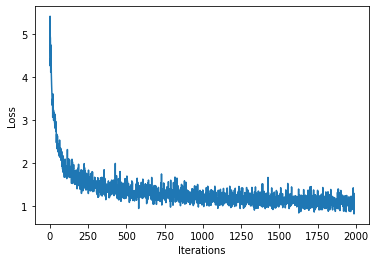

100%|██████████| 2000/2000 [03:20<00:00,  9.98it/s]


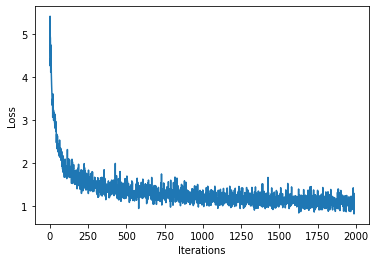

In [0]:
model = build_model(vocab_size, embedding_dim, rnn_units, batch_size)


optimizer = tf.keras.optimizers.Adam(learning_rate)

@tf.function
def train_step(x, y):
    with tf.GradientTape() as tape:
        
        y_hat = model(x)
        
        loss = compute_loss(y, y_hat)


    
    grads = tape.gradient(loss, model.trainable_variables )
    optimizer.apply_gradients(zip(grads, model.trainable_variables))
    return loss


history = []
plotter = mdl.util.PeriodicPlotter(sec=2, xlabel='Iterations', ylabel='Loss')
if hasattr(tqdm, '_instances'): tqdm._instances.clear() 

for iter in tqdm(range(num_training_iterations)):
    x_batch, y_batch = get_batch(vectorized_songs, seq_length, batch_size)
    loss = train_step(x_batch, y_batch)


    history.append(loss.numpy().mean())
    plotter.plot(history)


    if iter % 100 == 0:
        model.save_weights(checkpoint_prefix)
    
model.save_weights(checkpoint_prefix)

In [0]:
model = build_model(vocab_size, embedding_dim, rnn_units, batch_size=1)

model.load_weights(tf.train.latest_checkpoint(checkpoint_dir))
model.build(tf.TensorShape([1, None]))

model.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_2 (Embedding)      (1, None, 256)            21248     
_________________________________________________________________
lstm_2 (LSTM)                (1, None, 1024)           5246976   
_________________________________________________________________
dense_2 (Dense)              (1, None, 83)             85075     
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


# The prediction procedure
Now, we're ready to write the code to generate text in the ABC music format:

Initialize a "seed" start string and the RNN state, and set the number of characters we want to generate.

Use the start string and the RNN state to obtain the probability distribution over the next predicted character.

Sample from multinomial distribution to calculate the index of the predicted character. This predicted character is then used as the next input to the model.

At each time step, the updated RNN state is fed back into the model, so that it now has more context in making the next prediction. After predicting the next character, the updated RNN states are again fed back into the model, which is how it learns sequence dependencies in the data, as it gets more information from the previous predictions.

![alt text](https://camo.githubusercontent.com/7fe77db94dd40e1dfda455189f7064977d8b9946/68747470733a2f2f7261772e67697468756275736572636f6e74656e742e636f6d2f61616d696e692f696e74726f746f646565706c6561726e696e672f323031392f6c6162312f696d672f6c73746d5f696e666572656e63652e706e67)



In [0]:
def generate_text(model, start_string, generation_length=1000):

    input_eval = [char2idx[s] for s in start_string]
    input_eval = tf.expand_dims(input_eval, 0)

    text_generated = []
    model.reset_states()
    tqdm._instances.clear()


    for i in tqdm(range(generation_length)):
        predictions = model(input_eval)

        predictions = tf.squeeze(predictions, 0)
        predicted_id = tf.random.categorical(predictions, num_samples=1)[-1,0].numpy()

        input_eval = tf.expand_dims([predicted_id], 0)
        text_generated.append(idx2char[predicted_id])
    
    return (start_string + ''.join(text_generated))

In [0]:
generated_text = generate_text(model, start_string="X", generation_length=1000)

100%|██████████| 1000/1000 [00:06<00:00, 152.95it/s]


In [0]:
generated_songs = mdl.lab1.extract_song_snippet(generated_text)

for i, song in enumerate(generated_songs):
    waveform = mdl.lab1.play_song(song)



    if waveform:
        print("Generated song", i)
        ipythondisplay.display(waveform)

Found 2 songs in text
Generated song 0


Generated song 1
